<!-- # Ross Sea synthetic gravity inversion -->

<!-- import packages -->

In [2]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
import harmonica as hm
import copy
import itertools
import logging
import os
import shapely
import pathlib
import pickle
import shutil
import geopandas as gpd
import numpy as np
import pandas as pd
import verde as vd
import xarray as xr
import pygmt
from polartoolkit import utils as polar_utils
from polartoolkit import maps, fetch
from tqdm.autonotebook import tqdm

import RIS_gravity_inversion.plotting as RIS_plotting
import RIS_gravity_inversion.synthetic as RIS_synth

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, optimization, plotting, regional, synthetic, utils

In [3]:
ensemble_path = "../../results/Ross_Sea_08_grav_spacing_vs_noise_ensemble_low_regional_100_noise_then_survey"
ensemble_fname = f"{ensemble_path}.csv"

<!-- # Get synthetic model data -->

INFO:root:converting to be reference to the WGS84 ellipsoid
INFO:root:spacing larger than original, filtering and resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


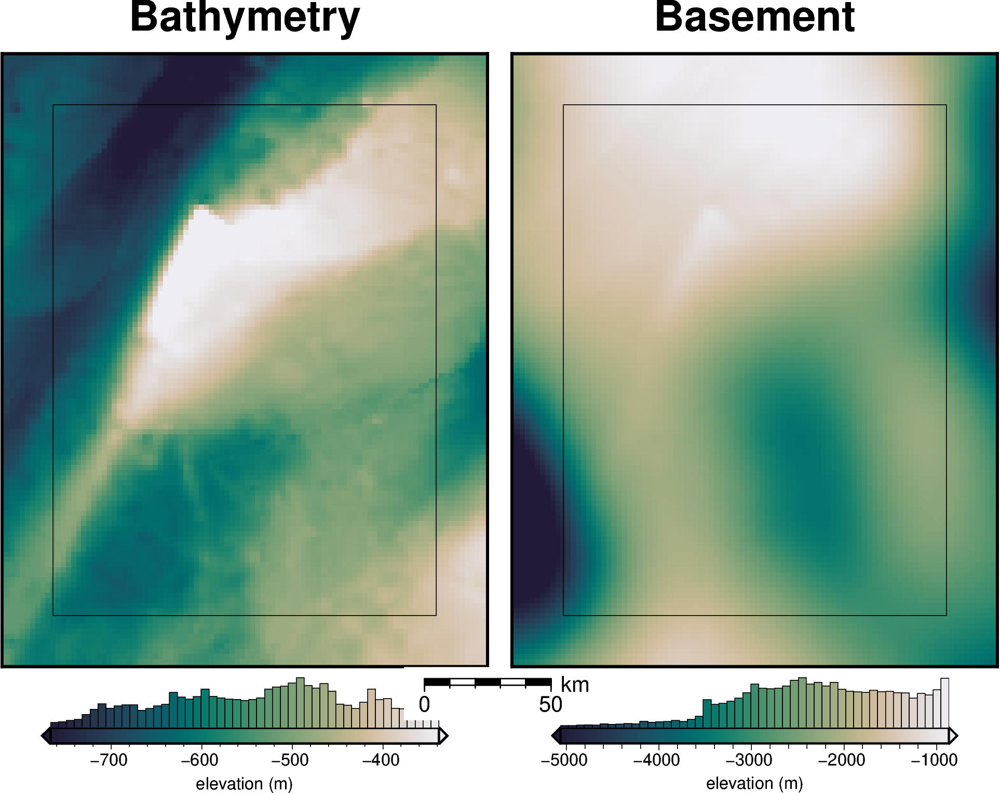

  0%|          | 0/7676 [00:00<?, ?it/s]

  0%|          | 0/7676 [00:00<?, ?it/s]

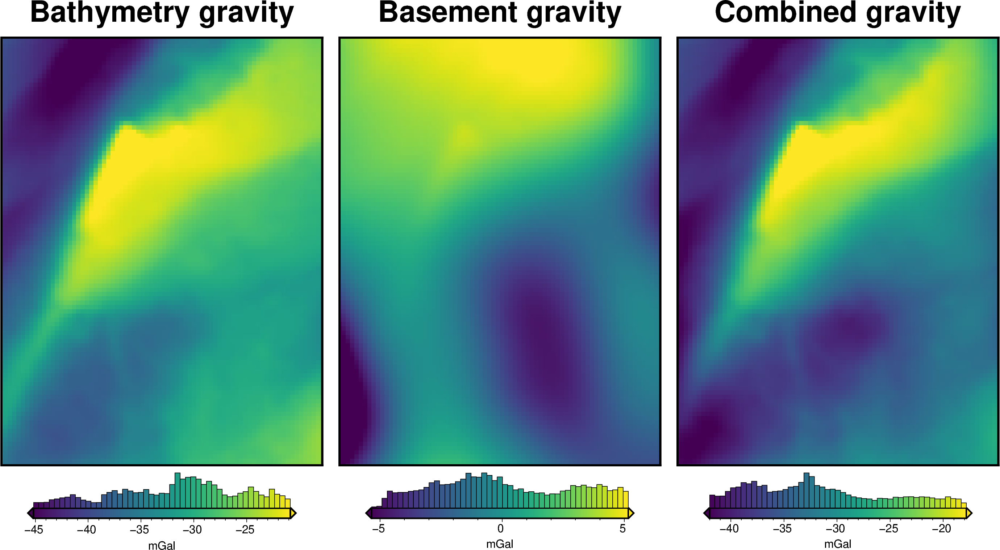

In [4]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, basement, original_grav_df = RIS_synth.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

In [5]:
# antgg = fetch.gravity(
#     region=inversion_region,
#     version="antgg-update",
#     anomaly_type="DG",
# )
# maps.plot_grd(
#     antgg,
#     cmap="viridis",
#     region=inversion_region,
#     hist=True,
#     title="AntGG gravity",
#     robust=True,
# )
# antgg -= antgg.mean()
# utils.rmse(antgg)

In [6]:
# normalize regional gravity between -1 and 1
original_grav_df["basement_grav_normalized"] = (
    vd.grid_to_table(
        utils.normalize_xarray(
            original_grav_df.set_index(["northing", "easting"])
            .to_xarray()
            .basement_grav,
            low=-1,
            high=1,
        )
    )
    .reset_index()
    .basement_grav
)
original_grav_df = original_grav_df.drop(
    columns=["basement_grav", "disturbance", "gravity_anomaly"]
)
original_grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951
...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841


In [7]:
# re-scale the regional gravity
regional_grav = utils.normalize_xarray(
    original_grav_df.set_index(["northing", "easting"])
    .to_xarray()
    .basement_grav_normalized,
    low=0,
    high=5,
).rename("basement_grav")
regional_grav -= regional_grav.mean()

# add to dataframe
original_grav_df["basement_grav"] = (
    vd.grid_to_table(regional_grav).reset_index().basement_grav
)

# add basement and bathymetry forward gravities together to make observed gravity
original_grav_df["gravity_anomaly_full_res_no_noise"] = (
    original_grav_df.bathymetry_grav + original_grav_df.basement_grav
)

new_reg = original_grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav
new_reg -= new_reg.mean()
utils.rmse(new_reg)

np.float64(1.0228297285938708)

In [8]:
original_grav_df["basement_grav"].std()

np.float64(1.0228963602820687)

In [9]:
# semi-regularly spaced
constraint_points = RIS_synth.constraint_layout_number(
    shape=(7, 9),
    region=inversion_region,
    padding=-spacing,
    shapefile="../../data/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points

,northing,easting,inside,true_upward,upward
0,-1.600000e+06,-40000.0,False,-601.093811,-601.093811
1,-1.600000e+06,-38000.0,False,-609.216797,-609.216797
2,-1.600000e+06,-36000.0,False,-616.356018,-616.356018
3,-1.600000e+06,-34000.0,False,-621.262207,-621.262207
4,-1.600000e+06,-32000.0,False,-625.510864,-625.510864
...,...,...,...,...,...
902,-1.415556e+06,15000.0,True,-724.708368,-724.708368
903,-1.415556e+06,35000.0,True,-564.963648,-564.963648
904,-1.415556e+06,55000.0,True,-484.549603,-484.549603
905,-1.415556e+06,75000.0,True,-424.391137,-424.391137


<!-- # Set filename -->

<!-- # Make starting bathymetry model -->

In [10]:
# calculate gravity data median distance
grd = bathymetry.sel(easting=slice(*inversion_region[:2]), northing=slice(*inversion_region[2:]))

grd = fetch.resample_grid(grd, spacing=100, verbose="q").rename({"x": "easting", "y": "northing"})

min_dist = utils.dist_nearest_points(
    constraint_points,
    grd,
).min_dist
print(f"Median constraint proximity: {int(min_dist.median().values)} m")

Median constraint proximity: 6768 m


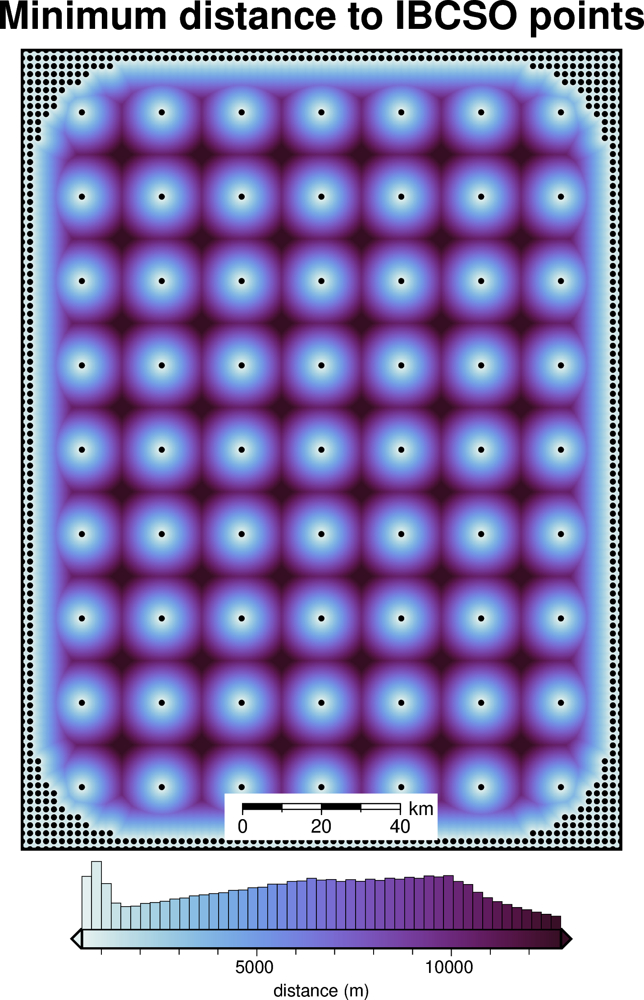

In [11]:
fig = maps.plot_grd(
    min_dist,
    region=inversion_region,
    title="Minimum distance to IBCSO points",
    cbar_label="distance (m)",
    cmap="dense",
    hist=True,
    robust=True,
    points=constraint_points,
    points_style="c2p",
    points_fill="black",
    scalebar=True,
)
fig.show()

In [12]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.27054456, -544.6013187 , -547.95466462, ..., -360.32126574,
        -357.42148437, -354.58759037],
       [-543.36666503, -546.84232457, -550.3801066 , ..., -363.20976805,
        -360.30987762, -357.49096608],
       [-545.07518132, -548.68298408, -552.39953554, ..., -365.9560243 ,
        -363.0626249 , -360.26735717],
       ...,
       [-592.07171808, -595.64574926, -599.20406916, ..., -440.82715547,
        -440.654165  , -440.39161122],
       [-590.66989834, -594.23922921, -597.7992238 , ..., -440.59445864,
        -440.35487921, -440.02882272],
       [-589.32604147, -592.90604323, -596.48458617, ..., -440.38830653,
        -440.069986  , -439.67111687]])
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [ ]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.starting_bathymetry)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.06 m


In [22]:
# save to file
bathymetry_path = pathlib.Path(ensemble_path+"_starting_bathymetry").with_suffix(".nc")
starting_bathymetry.drop_attrs().to_netcdf(bathymetry_path)

constraints_path = pathlib.Path(ensemble_path+"_constraints").with_suffix(".csv")
constraint_points.to_csv(constraints_path)

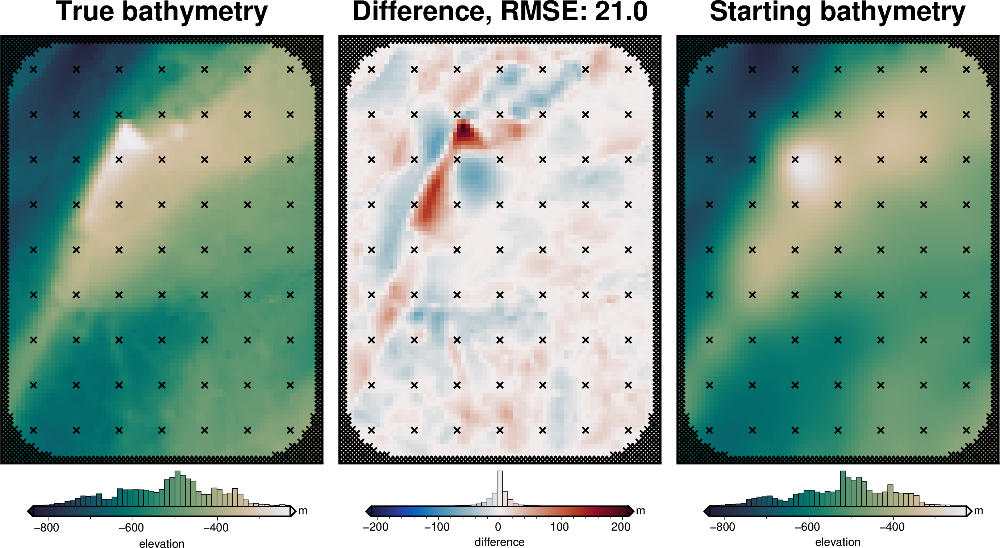

In [14]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    cbar_yoffset=1,
    label_font="16p,Helvetica,black",
    points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    points_style="x.2c",
)

In [15]:
# the true density contrast is 1476 kg/m3
density_contrast = 1476

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

original_grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        original_grav_df.easting,
        original_grav_df.northing,
        original_grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

original_grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-2.016608,-37.567649,-35.576169
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-1.885823,-37.940475,-36.039682
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-1.743848,-38.216996,-36.456482
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-1.593087,-38.348699,-36.780249
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-1.435984,-38.387016,-36.993123
...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,0.421658,-25.338722,-25.496257
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,0.260819,-25.650911,-25.672337
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,0.095824,-25.937304,-25.807715
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-0.071505,-26.193737,-25.903759


## Set line spacings and noise levels

<!-- # Run ensemble of inversions with varying survey line spacing and noise -->

In [16]:
num = 10

# Define number of flights lines on log scale
grav_line_numbers = np.unique(np.round(np.geomspace(3, 30, num)))
grav_line_numbers = [round(i) for i in grav_line_numbers]
assert len(grav_line_numbers) == num

# Define noise levels for grav data
grav_noise_levels = [float(round(x, 2)) for x in np.linspace(0, 2.5, num)]

print("number of grav lines:", grav_line_numbers)
print("grav noise levels:", grav_noise_levels)

number of grav lines: [3, 4, 5, 6, 8, 11, 14, 18, 23, 30]
grav noise levels: [0.0, 0.28, 0.56, 0.83, 1.11, 1.39, 1.67, 1.94, 2.22, 2.5]


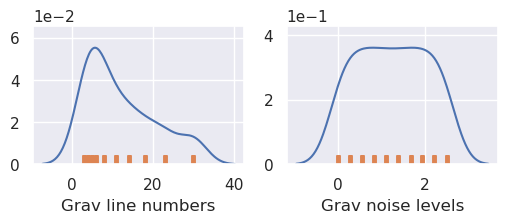

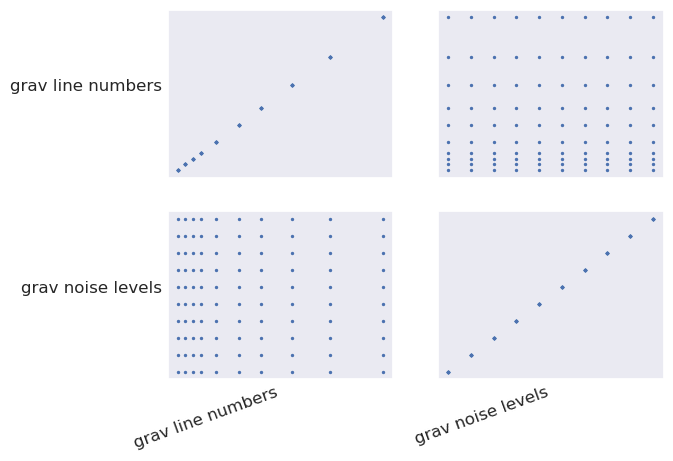

In [23]:
# turn into dataframe
sampled_params_df = pd.DataFrame(
    itertools.product(
        grav_line_numbers,
        grav_noise_levels,
    ),
    columns=[
        "grav_line_numbers",
        "grav_noise_levels",
    ],
)

sampled_params_dict = dict(
    grav_line_numbers=dict(sampled_values=sampled_params_df.grav_line_numbers),
    grav_noise_levels=dict(sampled_values=sampled_params_df.grav_noise_levels),
)

plotting.plot_latin_hypercube(
    sampled_params_dict,
)

<!-- # Create observed gravity
* sample full-res gravity along flight lines
* grid flight line data with equivalent sources

Only need to do this for unique grav_line_numbers  -->

In [24]:
sampled_params_df

,grav_line_numbers,grav_noise_levels
0,3,0.00
1,3,0.28
2,3,0.56
3,3,0.83
4,3,1.11
...,...,...
95,30,1.39
96,30,1.67
97,30,1.94
98,30,2.22


## Contaminate gravity with noise

In [25]:
# fnames to save files for each ensemble
sampled_params_df["grav_df_fname"] = pd.Series()

grav_grid = original_grav_df.set_index(["northing", "easting"]).to_xarray()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):

    # set file names
    grav_df_fname = f"{ensemble_path}_grav_df_{i}.csv"

    grav_df = original_grav_df.copy()

    # contaminated with long-wavelength noise
    grav_df["gravity_anomaly_full_res"] = grav_df.gravity_anomaly_full_res_no_noise
    with utils._log_level(logging.ERROR):
        contaminated = synthetic.contaminate_with_long_wavelength_noise(
            grav_grid.gravity_anomaly_full_res_no_noise,
            coarsen_factor=None,
            spacing=20e3,
            noise_as_percent=False,
            noise=row.grav_noise_levels,
        )
    contaminated_df = vd.grid_to_table(
        contaminated.rename("gravity_anomaly_full_res")
    ).reset_index(drop=True)

    grav_df = pd.merge(  # noqa: PD015
        grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
        contaminated_df,
        on=["easting", "northing"],
    )

    # short-wavelength noise
    with utils._log_level(logging.ERROR):
        contaminated = synthetic.contaminate_with_long_wavelength_noise(
            grav_df.set_index(["northing", "easting"]).to_xarray().gravity_anomaly_full_res,
            coarsen_factor=None,
            spacing=spacing*2,
            noise_as_percent=False,
            noise=row.grav_noise_levels,
        )
    contaminated_df = vd.grid_to_table(
        contaminated.rename("gravity_anomaly_full_res")
    ).reset_index(drop=True)

    grav_df = pd.merge(  # noqa: PD015
        grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
        contaminated_df,
        on=["easting", "northing"],
    )

    # add noise level to uncert column
    grav_df["uncert"] = row.grav_noise_levels

    # save to files
    grav_df.to_csv(grav_df_fname, index=False)

    # add to dataframe
    sampled_params_df.loc[i, "grav_df_fname"] = grav_df_fname

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...


In [26]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [27]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...


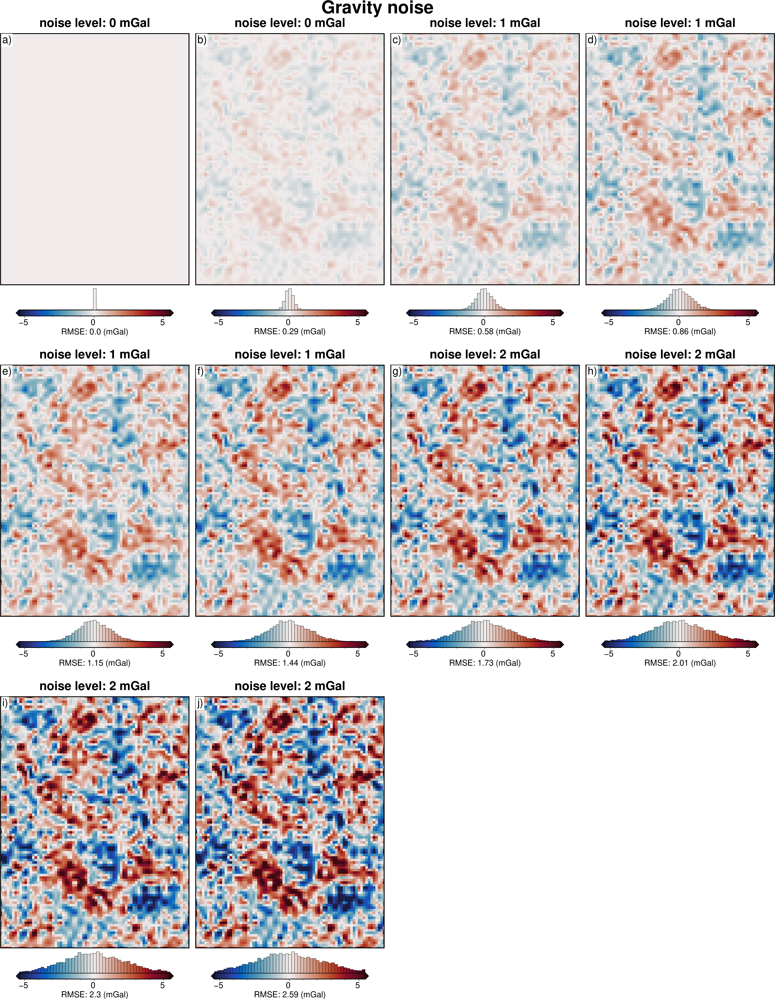

In [28]:
# subplots showing grav data loss from sampling
grids = []
titles = []
cbar_labels = []
for i, row in sampled_params_df.iterrows():
    if i < num:
        grav_df = pd.read_csv(row.grav_df_fname)
        grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
        dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly_full_res
        # add to lists
        grids.append(dif)
        titles.append(f"noise level: {round(row.grav_noise_levels)} mGal")
        cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")

fig = maps.subplots(
    grids,
    fig_title="Gravity noise",
    titles=titles,
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
)

fig.show()

## Sample along flightlines and interpolate

In [29]:
logging.getLogger().setLevel(logging.WARNING)

# add empty columns
# fnames to save files for each ensemble
sampled_params_df["grav_survey_df_fname"] = pd.Series()
# average of the east/west and north/south line spacings
sampled_params_df["grav_line_spacing"] = pd.Series()

# sampled_params_df["grav_eqs_damping"] = np.nan
# sampled_params_df["grav_eqs_depth"] = pd.Series()
# sampled_params_df["grav_eqs_score"] = np.nan

sampled_params_df["grav_data_loss_rmse"] = np.nan
sampled_params_df["grav_data_loss_mae"] = np.nan

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):

    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    grav_survey_df_fname = f"{ensemble_path}_grav_survey_df_{i}.csv"

    # create flight lines
    grav_survey_df = RIS_synth.airborne_survey(
        along_line_spacing=500,
        grav_observation_height=1e3,
        NS_line_number=row.grav_line_numbers,
        EW_line_number=row.grav_line_numbers,
        region=inversion_region,
        grav_grid=grav_df.set_index(["northing", "easting"])
        .to_xarray()
        .gravity_anomaly_full_res,
        plot=False,
    )
    x_spacing = (inversion_region[1] - inversion_region[0]) / row.grav_line_numbers
    y_spacing = (inversion_region[3] - inversion_region[2]) / row.grav_line_numbers
    grav_line_spacing = ((x_spacing + y_spacing) / 2) / 1e3

    eqs = hm.EquivalentSources(
        damping=1,
        depth="default",
        block_size=spacing,
    )
    eqs.fit(
        (grav_survey_df.easting, grav_survey_df.northing, grav_survey_df.upward),
         grav_survey_df.gravity_anomaly,
    )
    # # grid the airborne survey data with equivalent sources
    # eqs_study, eqs = optimization.optimize_eq_source_params(
    #     (grav_survey_df.easting, grav_survey_df.northing, grav_survey_df.upward),
    #     grav_survey_df.gravity_anomaly,
    #     n_trials=6,
    #     damping_limits=(0.1, 100),
    #     # depth_limits=(100, 100e3),
    #     depth="default",
    #     block_size=spacing,
    #     # plot=True,
    #     progressbar=False,
    #     fname="../../results/Ross_Sea_08_eqs",
    # )

    # predict sources onto grid
    grav_df["gravity_anomaly"] = eqs.predict(
        (
            grav_df.easting,
            grav_df.northing,
            grav_df.upward,
        ),
    )
    # grav_grid = pygmt.surface(
    #     data=grav_survey_df[["easting", "northing", "gravity_anomaly"]],
    #     region=inversion_region,
    #     spacing=spacing,
    #     tension=0.25,
    #     verbose="q",
    # )
    # grav_df = utils.sample_grids(
    #     grav_df.drop(columns=["gravity_anomaly"]),
    #     grav_grid,
    #     sampled_name="gravity_anomaly",
    # )

    # add to dataframe
    sampled_params_df.loc[i, "grav_line_spacing"] = grav_line_spacing
    # sampled_params_df.loc[i, "grav_eqs_damping"] = eqs_study.best_trial.params[
    #     "damping"
    # ]
    # sampled_params_df.loc[i, "grav_eqs_depth"] = eqs_study.best_trial.params[
    #     "depth"
    # ]
    # sampled_params_df.loc[i, "grav_eqs_score"] = eqs_study.best_trial.value
    dif = grav_df.gravity_anomaly_full_res_no_noise - grav_df.gravity_anomaly
    sampled_params_df.loc[i, "grav_data_loss_rmse"] = float(utils.rmse(dif))
    sampled_params_df.loc[i, "grav_data_loss_mae"] = float(np.abs(dif).mean())

    # save to files
    grav_survey_df.to_csv(grav_survey_df_fname, index=False)
    grav_df.to_csv(row.grav_df_fname, index=False)

    # add to dataframe
    sampled_params_df.loc[i, "grav_survey_df_fname"] = grav_survey_df_fname

sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794
...,...,...,...,...,...,...,...
95,30,1.39,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.265700,1.004706
96,30,1.67,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.519144,1.205794
97,30,1.94,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.763676,1.399804
98,30,2.22,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,2.017355,1.601094


In [27]:
# print(
#     "Equivalent source gridding results:\n",
#     f"best dampings: {sampled_params_df.grav_eqs_damping.unique()}\n",
#     f"best depths: {sampled_params_df.grav_eqs_depth.unique()}\n",
#     f"best_scores: {sampled_params_df.grav_eqs_score.unique()}\n",
# )

In [30]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [31]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794


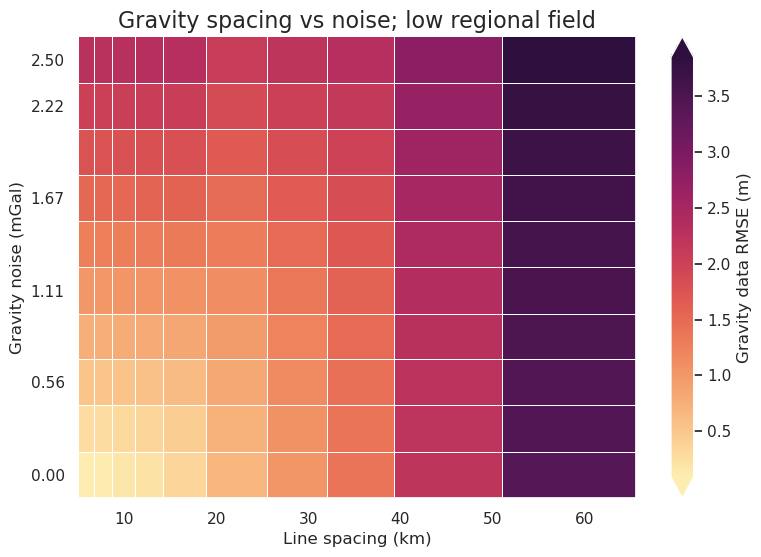

In [44]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="grav_data_loss_rmse",
    background_title="Gravity data RMSE (m)",
    # points_color="grav_eqs_damping",
    # background="regional_error",
    # background_title="Regional gravity RMSE (mGal)",
    # background_robust=True,
    # background_cpt_lims=[inversion_rmse_lims[0], starting_bathymetry_rmse * 2],
    # plot_contours=[starting_bathymetry_rmse],
    plot_title="Gravity spacing vs noise; low regional field",
)

In [33]:
# subplots showing grav data loss from sampling and noise
grids = []
cbar_labels = []
row_titles = []
column_titles = []
surveys = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels,1))
    # get survey points
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)
    surveys.append(grav_survey_df)

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Data loss from airborne surveying and noise",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    # fig_x_axis_title_y_offset="-2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    point_sets=surveys,
    points_style="p.02c",
)
fig.show()

In [34]:
# subplots showing true gravity and sampled-noisy gravity
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=[False,True]).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

    # dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly

    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly


    # add to lists
    grids.append(grav_grid.gravity_anomaly_full_res_no_noise)
    grids.append(grav_grid.gravity_anomaly)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels,1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2*np.sqrt(len(df))),
    fig_height=8,
    fig_title="Low regional",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["viridis"]*2 for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[x for xs in [
        [polar_utils.get_combined_min_max(grids, robust=True)]*2 for x in range(len(df))] for x in xs],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.show()

## Estimate and separate regional

In [35]:
def regional_comparison(df):
    # grid the results
    grav_grid = df.set_index(["northing", "easting"]).to_xarray()

    # compare with true regional
    _ = polar_utils.grd_compare(
        grav_grid.basement_grav,
        grav_grid.reg,
        plot=True,
        grid1_name="True regional misfit",
        grid2_name="Regional misfit",
        hist=True,
        cbar_yoffset=1,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
        points_style="x.3c",
    )
    # compare with true residual
    # _ = polar_utils.grd_compare(
    #     grav_grid.true_res,
    #     grav_grid.res,
    #     plot=True,
    #     grid1_name="True residual misfit",
    #     grid2_name="Residual misfit",
    #     cmap="balance+h0",
    #     hist=True,
    #     cbar_yoffset=1,
    #     inset=False,
    #     verbose="q",
    #     title="difference",
    #     grounding_line=False,
    #     points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    #     points_style="x.3c",
    # )

In [36]:
# estimate regional
# regional_grav_kwargs = dict(
#     method="constraints",
#     grid_method="eq_sources",
#     cv=True,
#     cv_kwargs=dict(
#         n_trials=50,
#         # damping_limits=(1e-30, 10),
#         depth_limits=(100, 100e3),
#         progressbar=False,
#         fname="../../tmp_outputs/Ross_Sea_08_regional_sep",
#     ),
#     constraints_df=constraint_points,
#     # depth="default",
#     damping=None,
#     block_size=None,
# )
regional_grav_kwargs = dict(
    method="constraints",
    grid_method="pygmt",
    constraints_df=constraint_points,
    tension_factor=0.25,
)

In [37]:
logging.getLogger().setLevel(logging.WARNING)

# sampled_params_df["reg_eqs_damping"] = pd.Series()
# sampled_params_df["reg_eqs_depth"] = pd.Series()
# sampled_params_df["reg_eqs_score"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # calculate the true residual misfit
    # grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity
    grav_df["true_res"] = grav_df.gravity_anomaly - grav_df.starting_gravity - grav_df.basement_grav

    # temporarily set some kwargs
    temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)
    # temp_reg_kwargs["cv_kwargs"]["fname"] = f"../../tmp_outputs/Ross_Sea_08_regional_sep_{i}"
    # temp_reg_kwargs["cv_kwargs"]["plot"]=True
    # temp_reg_kwargs["cv_kwargs"]["progressbar"]=True

    grav_df = regional.regional_separation(
        grav_df=grav_df,
        **temp_reg_kwargs,
    )
    # regional_comparison(grav_df)

    # # re-load the study from the saved pickle file
    # with pathlib.Path(f"../../tmp_outputs/Ross_Sea_08_regional_sep_{i}.pickle").open("rb") as f:
    #     reg_study = pickle.load(f)
    # # reg_eq_damping = min(reg_study.best_trials, key=lambda t: t.values[0]).params[
    # #     "damping"
    # # ]
    # reg_eq_depth = min(reg_study.best_trials, key=lambda t: t.values[0]).params["depth"]
    # reg_score = reg_study.best_trial.value

    # # add to dataframe
    # # sampled_params_df.loc[i, "reg_eqs_damping"] = reg_eq_damping
    # sampled_params_df.loc[i, "reg_eqs_depth"] = reg_eq_depth
    # sampled_params_df.loc[i, "reg_eqs_score"] = reg_score

    # resave gravity dataframe
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794


In [38]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [39]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794


In [40]:
sampled_params_df["regional_error"] = np.nan
sampled_params_df["residual_error"] = np.nan
sampled_params_df["regional_rms"] = np.nan

for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "regional_error"] = utils.rmse(
        grav_df.basement_grav - grav_df.reg
    )
    sampled_params_df.loc[i, "residual_error"] = utils.rmse(
        grav_df.true_res - grav_df.res
    )
    sampled_params_df.loc[i, "regional_rms"] = utils.rmse(grav_df.basement_grav)

sampled_params_df  # .head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283
...,...,...,...,...,...,...,...,...,...,...
95,30,1.39,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.265700,1.004706,0.857458,0.857458,1.02283
96,30,1.67,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.519144,1.205794,1.021451,1.021451,1.02283
97,30,1.94,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.763676,1.399804,1.180408,1.180408,1.02283
98,30,2.22,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,2.017355,1.601094,1.345816,1.345816,1.02283


In [41]:
# subplots showing regional gravity errors
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.basement_grav - grav_grid.reg
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels,1))

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Regional estimation error",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    # fig_x_axis_title_y_offset="-2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    points=constraint_points,
)
fig.show()

In [42]:
# subplots showing regional gravity errors
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.res
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels,1))

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Estimated residual",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    # fig_x_axis_title_y_offset="-2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    points=constraint_points,
)
fig.show()

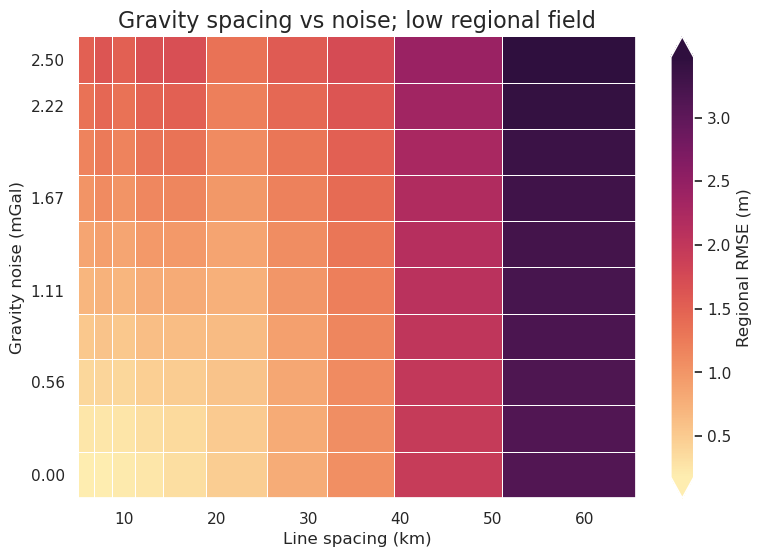

In [45]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="regional_error",
    background_title="Regional RMSE (m)",
    # background="regional_error",
    # background_title="Regional gravity RMSE (mGal)",
    # background_robust=True,
    # background_cpt_lims=[inversion_rmse_lims[0], starting_bathymetry_rmse * 2],
    # plot_contours=[starting_bathymetry_rmse],
    plot_title="Gravity spacing vs noise; low regional field",
)

## Damping CV

<!-- # Damping Cross Validation -->

In [46]:
logging.getLogger().setLevel(logging.WARNING)

sampled_params_df["damping_cv_results_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = 0.2**0.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**0.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200,
        "l2_norm_tolerance": l2_norm_tolerance,  # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
    }

    # set results file name
    damping_cv_results_fname = f"{ensemble_path}_damping_cv_{i}"

    # run the inversion workflow, including a cross validation for the damping parameter
    _ = inversion.run_inversion_workflow(
        grav_df=grav_df,
        starting_prisms=starting_prisms,
        # for creating test/train splits254
        grav_spacing=spacing,
        inversion_region=inversion_region,
        run_damping_cv=True,
        # damping_limits=(0.001, 0.1),
        # damping_cv_trials=8,
        damping_limits=(0.025, 0.025),
        damping_cv_trials=1,
        damping_cv_startup_trials=1,
        damping_cv_progressbar=False,
        # plot_cv=True,
        fname=damping_cv_results_fname,
        **kwargs,
    )

    # add results file name
    sampled_params_df.loc[i, "damping_cv_results_fname"] = damping_cv_results_fname

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,damping_cv_results_fname
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...


In [47]:
sampled_params_df["best_damping"] = pd.Series()
sampled_params_df["constraints_damping_cv_rmse"] = pd.Series()
sampled_params_df["inversion_rmse"] = np.nan#pd.Series()
sampled_params_df["inversion_mae"] = pd.Series()
sampled_params_df["inverted_bathymetry_fname"] = pd.Series()

for i, row in sampled_params_df.iterrows():
    # load saved inversion results
    with pathlib.Path(f"{row.damping_cv_results_fname}_results.pickle").open("rb") as f:
        results = pickle.load(f)

    # load study
    with pathlib.Path(f"{row.damping_cv_results_fname}_damping_cv_study.pickle").open(
        "rb"
    ) as f:
        study = pickle.load(f)

    # collect the results
    topo_results, grav_results, parameters, elapsed_time = results
    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # add best damping to dataframe
    sampled_params_df.loc[i, "best_damping"] = parameters.get("Solver damping")

    # if row.grav_line_spacing==175:
    # if row.grav_noise_levels==0:
    # plotting.plot_convergence(
    #     grav_results,
    #     params=parameters,
    # )

    # plotting.plot_cv_scores(
    #         study.trials_dataframe().value.values,
    #         study.trials_dataframe().params_damping.values,
    #         param_name="Damping",
    #         logx=True,
    #         logy=True,
    #     )

    # plotting.plot_inversion_results(
    #     grav_results,
    #     topo_results,
    #     parameters,
    #     inversion_region,
    #     iters_to_plot=2,
    #     # plot_iter_results=False,
    #     plot_topo_results=False,
    #     plot_grav_results=False,
    # )

    # _ = polar_utils.grd_compare(
    #     bathymetry,
    #     final_bathymetry,
    #     region=inversion_region,
    #     plot=True,
    #     grid1_name="True topography",
    #     grid2_name="Inverted topography",
    #     robust=True,
    #     hist=True,
    #     inset=False,
    #     verbose="q",
    #     title="difference",
    #     grounding_line=False,
    #     reverse_cpt=True,
    #     cmap="rain",
    #     points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    #     points_style="x.2c",
    # )

    # sample the inverted topography at the constraint points
    constraint_points = utils.sample_grids(
        constraint_points,
        final_bathymetry,
        "inverted_damping_cv_bathymetry",
        coord_names=("easting", "northing"),
    )
    constraints_rmse = utils.rmse(
        constraint_points.true_upward - constraint_points.inverted_damping_cv_bathymetry
    )
    reg = vd.pad_region(inversion_region, -spacing*3)
    # reg = inversion_region

    bathymetry_inner = bathymetry.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    final_bathymetry_inner = final_bathymetry.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    inversion_rmse = utils.rmse(bathymetry_inner - final_bathymetry_inner)
    inversion_mae = float(np.mean(np.abs(bathymetry_inner - final_bathymetry_inner)))

    # save final topography to file
    inverted_bathymetry_fname = f"{ensemble_path}_inverted_damping_cv_bathymetry_{i}.nc"
    final_bathymetry.to_netcdf(inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "inverted_bathymetry_fname"] = inverted_bathymetry_fname
    sampled_params_df.loc[i, "constraints_damping_cv_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "inversion_rmse"] = inversion_rmse
    sampled_params_df.loc[i, "inversion_mae"] = inversion_mae

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,damping_cv_results_fname,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.025609,23.456574,14.507253,../../results/Ross_Sea_08_grav_spacing_vs_nois...
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.07551,23.428339,14.552381,../../results/Ross_Sea_08_grav_spacing_vs_nois...
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.161874,23.678176,14.864379,../../results/Ross_Sea_08_grav_spacing_vs_nois...
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.272814,24.174831,15.425643,../../results/Ross_Sea_08_grav_spacing_vs_nois...
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.409636,24.938757,16.201179,../../results/Ross_Sea_08_grav_spacing_vs_nois...


In [48]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [49]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,damping_cv_results_fname,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.025609,23.456574,14.507253,../../results/Ross_Sea_08_grav_spacing_vs_nois...
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.075510,23.428339,14.552381,../../results/Ross_Sea_08_grav_spacing_vs_nois...
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.161874,23.678176,14.864379,../../results/Ross_Sea_08_grav_spacing_vs_nois...
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.272814,24.174831,15.425643,../../results/Ross_Sea_08_grav_spacing_vs_nois...
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.409636,24.938757,16.201179,../../results/Ross_Sea_08_grav_spacing_vs_nois...


In [50]:
# subplots showing inverted bathymetry error
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
    dif = bathymetry - xr.open_dataarray(row.inverted_bathymetry_fname)
    reg = vd.pad_region(inversion_region, -3*spacing)
    # reg = inversion_region
    dif = dif.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")
    if i % num == 0:
        column_titles.append(f"Spacing: {round(row.grav_line_spacing)} km")
    if i < num:
        row_titles.append(f"Noise: {round(row.grav_noise_levels,1)} mGal")

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Inverted bathymetry error",
    fig_title_font="75p,Helvetica-Bold,black",
    fig_title_y_offset="5c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="25p,Helvetica,black",
    column_titles_font="25p,Helvetica,black",
)
fig.show()

<!-- ## Density CV -->

In [51]:
sampled_params_df["regional_error"] = pd.Series()
sampled_params_df["residual_error"] = pd.Series()
sampled_params_df["regional_rms"] = pd.Series()

for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "regional_error"] = utils.rmse(
        grav_df.basement_grav - grav_df.reg
    )
    sampled_params_df.loc[i, "residual_error"] = utils.rmse(
        grav_df.true_res - grav_df.res
    )
    sampled_params_df.loc[i, "regional_rms"] = utils.rmse(grav_df.basement_grav)


reg = vd.pad_region(inversion_region, -spacing*3)
# reg = inversion_region

starting_bathymetry = starting_bathymetry.sel(
    easting=slice(reg[0], reg[1]),
    northing=slice(reg[2], reg[3]),
)
inside_bathymetry = bathymetry.sel(
    easting=slice(reg[0], reg[1]),
    northing=slice(reg[2], reg[3]),
)

starting_bathymetry_mae = float(np.mean(np.abs(inside_bathymetry - starting_bathymetry)))
starting_bathymetry_rmse = utils.rmse(inside_bathymetry - starting_bathymetry)

sampled_params_df["topo_improvement_rmse"] = (
    starting_bathymetry_rmse - sampled_params_df.inversion_rmse
)
sampled_params_df["topo_improvement_mae"] = (
    starting_bathymetry_mae - sampled_params_df.inversion_mae
)

sampled_params_df  # .head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,damping_cv_results_fname,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname,topo_improvement_rmse,topo_improvement_mae
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.025609,23.456574,14.507253,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.439174,-0.730117
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.075510,23.428339,14.552381,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.410938,-0.775245
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.161874,23.678176,14.864379,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.660776,-1.087243
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.272814,24.174831,15.425643,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.157430,-1.648506
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.21857,3.21857,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.409636,24.938757,16.201179,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.921357,-2.424043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.39,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.265700,1.004706,0.857458,0.857458,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,2.774886,26.901037,20.971005,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-4.883636,-7.193869
96,30,1.67,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.519144,1.205794,1.021451,1.021451,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,3.247116,32.110687,25.037627,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-10.093287,-11.260490
97,30,1.94,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.763676,1.399804,1.180408,1.180408,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,3.710672,37.154095,28.974728,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-15.136695,-15.197592
98,30,2.22,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,2.017355,1.601094,1.345816,1.345816,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,4.196945,42.397126,33.069601,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-20.379726,-19.292465


In [52]:
w = np.abs(inversion_region[1] - inversion_region[0]) / 1e3
h = np.abs(inversion_region[3] - inversion_region[2]) / 1e3
w, h

(np.float64(150.0), np.float64(200.0))

In [53]:
sampled_params_df["flight_kms"] = pd.Series()
for i, row in sampled_params_df.iterrows():
    survey_df = pd.read_csv(row.grav_survey_df_fname)
    # flight km is length of lines in km X number of lines
    sampled_params_df.loc[i, "flight_kms"] = w*row.grav_line_numbers + h*row.grav_line_numbers
sampled_params_df.flight_kms.unique()

array([np.float64(1050.0), np.float64(1400.0), np.float64(1750.0),
       np.float64(2100.0), np.float64(2800.0), np.float64(3850.0),
       np.float64(4900.0), np.float64(6300.0), np.float64(8050.0),
       np.float64(10500.0)], dtype=object)

In [54]:
inversion_area = (
    (inversion_region[1] - inversion_region[0])
    / 1e3
    * (inversion_region[3] - inversion_region[2])
    / 1e3
)
sampled_params_df["flight_kms_per_10000sq_km"] = (
    (sampled_params_df.flight_kms / inversion_area) * 10e3
).astype(float)
sampled_params_df.flight_kms_per_10000sq_km.unique()

array([ 350.        ,  466.66666667,  583.33333333,  700.        ,
        933.33333333, 1283.33333333, 1633.33333333, 2100.        ,
       2683.33333333, 3500.        ])

In [55]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [56]:
ensemble_fname[0:-4]

'../../results/Ross_Sea_08_grav_spacing_vs_noise_ensemble_low_regional_100_noise_then_survey'

In [57]:
# sampled_params_df.to_csv(f"{ensemble_fname[0:-4]}_backup.csv", index=False)

In [58]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,damping_cv_results_fname,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.025609,23.456574,14.507253,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.439174,-0.730117,1050.0,350.0
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.075510,23.428339,14.552381,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.410938,-0.775245,1050.0,350.0
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.161874,23.678176,14.864379,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.660776,-1.087243,1050.0,350.0
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.272814,24.174831,15.425643,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.157430,-1.648506,1050.0,350.0
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,1.409636,24.938757,16.201179,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.921357,-2.424043,1050.0,350.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.39,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.265700,1.004706,0.857458,0.857458,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,2.774886,26.901037,20.971005,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-4.883636,-7.193869,10500.0,3500.0
96,30,1.67,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.519144,1.205794,1.021451,1.021451,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,3.247116,32.110687,25.037627,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-10.093287,-11.260490,10500.0,3500.0
97,30,1.94,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,1.763676,1.399804,1.180408,1.180408,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,3.710672,37.154095,28.974728,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-15.136695,-15.197592,10500.0,3500.0
98,30,2.22,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,5.833333,2.017355,1.601094,1.345816,1.345816,1.02283,../../results/Ross_Sea_08_grav_spacing_vs_nois...,0.025,4.196945,42.397126,33.069601,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-20.379726,-19.292465,10500.0,3500.0


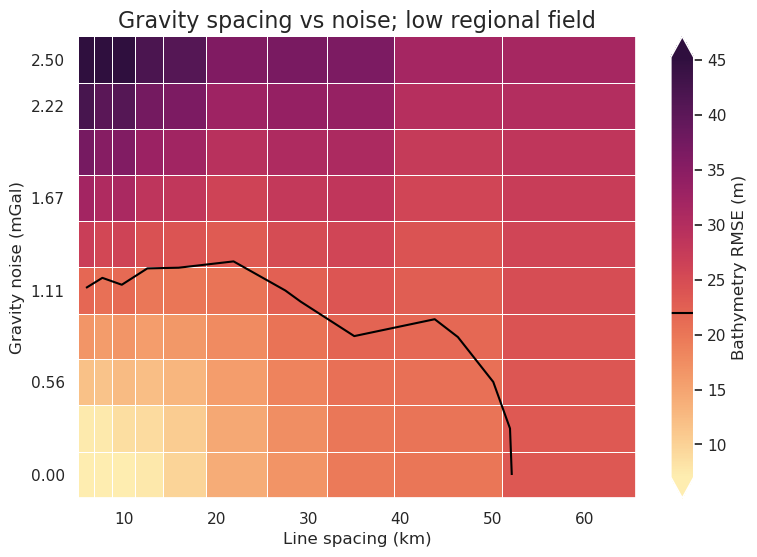

In [59]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    # background="regional_error",
    # background_title="Regional gravity RMSE (mGal)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    plot_title="Gravity spacing vs noise; low regional field",
)
# Results
# expected relationship between noise, line spacing and performance
# inversion only offers improvement for noise < 5mGal

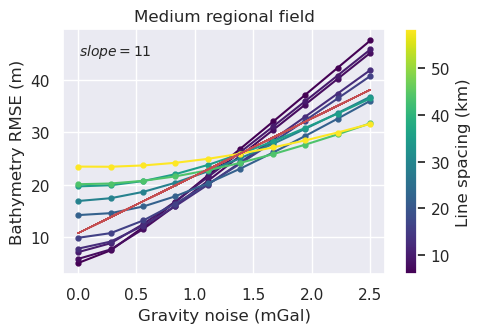

In [60]:
_ = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="inversion_rmse",
    x="grav_noise_levels",
    groupby_col="grav_line_spacing",
    x_label="Gravity noise (mGal)",
    cbar_label="Line spacing (km)",
    trend_line=True,
    # horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)
# Results
# linear relationship between noise and performance for all line spacings
# at high noise levels, lines spacing doesn't matter

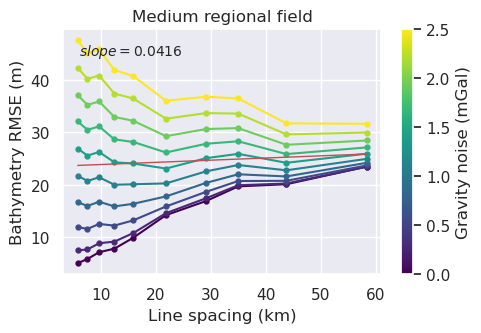

In [61]:
_ = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="inversion_rmse",
    x="grav_line_spacing",
    groupby_col="grav_noise_levels",
    x_label="Line spacing (km)",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    # horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)
# Results
# linear relationship between line spacing and performance for all noise levels
# even at low line spacings, noise still matters
# noise is slightly more important at smaller line spacings

# Noise is more important than line spacing!!